# Multivariable Linear Regression Model Training Using Momentum-based and Vanilla GD with Batch/mini-Batch/Stochastic Variants:
## Please read and follow the instructions very carefully (Good Luck).
### In this task you should implement a mini-batch momentum based gradient descent optimizer to train a multivariable linear regression model.
### Your optimizer should be able to work as Stochastic/mini-batch/Batch by just adjusting mini-batch size without any code modification.
### Your optimizer should also work as GD without momentum by adjusting the hyperparameter value (think how?) without any code modification.
### Make your implementation as a function.
### The function should return the model hyperparameters and required output for plotting the learning curves.
### Data shuffle and adding the first bias feature (containig ones) must be berformed inside the function.
### The optimizer must be able to deal with any mini-batch size.
### Maximum number of epochs must be stated in order to avoid infinite loop.
### Gradient check and cost convergence check stop criterias must be implemented.
### You must plot the following learning curves:
#### - Loss vs. iterations (not Epoch).
#### - Loss vs. theta0, loss vs. theta1, loss vs. theta2.
### You must evaluate your model using r2_score metrics and achieve at least 0.8 score in any scenario of your choice and plot all the learning curves.
### You must run (at least) the following scenarios and show results and learning curves for each scenario (Do not do new implementation for each scenario. Use your implemenation and change input parameter values of the function):
#### - Momentum based with mini-batch size of your choice.
#### - Momentum based with Stochastic Gradient Descent.
#### - Momentum based with Batch Gradient Descent.
#### - Vanilla GD with mini-batch size of your choice.
#### - Vanilla GD with Stochastic Gradient Descent.
#### - Vanilla GD with Batch Gradient Descent.
#### - Any scenario with mini-batch size 32.
### You must use vectorize implementation. i.e., you should not have only two loops one for epochs and one for iterations (Only optimizer's loops).
### Your function should take the following inputs:
#### Input features, target label, learning rate, momentum term, mini-batch size, max number of epochs, gradient check tolerence, cost convergence check tolerence, and any other argument you think useful.
### The function should initialize the model parameters to zeros.
### Generate a regression data with two input features and 500 observations (You can see a sample code below for data generation. feel free to change any of the values to btain your own data to achieve the required score).

In [2]:
import numpy as np
import pandas as pd
from sklearn.utils import shuffle
import matplotlib.pyplot as plt 
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

# Generate random data
np.random.seed(42) 

# Create 500 records
n_samples = 500

# Independent variables (features)
x1 = np.random.uniform(low=2.0, high=5.0, size=n_samples)
x2 = np.random.uniform(low=4.0, high=8.0, size=n_samples)

# Dependent variable (target)
y = 1000 + 50 * x1 - 30 * x2 + np.random.normal(loc=0, scale=10, size=n_samples)

# Create a DataFrame
data = {
    'x1': x1,
    'x2': x2,
    'y': y
}

df = pd.DataFrame(data)

df.head()  


,x1,x2,y
0,3.123620,6.792647,954.178622
1,4.852143,6.144385,1044.922138
2,4.195982,5.238110,1056.457756
3,3.795975,7.255180,978.249228
4,2.468056,6.738925,926.832960


# Your submission must be in .ipynb file format that contains all results and curves.
# Do not submit any link for a notebook.
# Do not forget to klick on Hand In after uploading your file.
# Good Luck

In [3]:
df=np.array(df)

In [10]:
x=df[:,:2]
y=df[:,-1]
y.shape,x.shape

((500,), (500, 2))

In [11]:
y=y.reshape(-1,1)

In [12]:
m=len(y)
ones=np.ones((m,1))
X=np.concatenate((ones,X),axis=1)
X

array([[1.        , 1.        , 3.12362036, 6.79264686],
       [1.        , 1.        , 4.85214292, 6.14438547],
       [1.        , 1.        , 4.19598183, 5.23811047],
       ...,
       [1.        , 1.        , 2.23320391, 4.54727452],
       [1.        , 1.        , 4.92318442, 7.80094942],
       [1.        , 1.        , 4.95863223, 5.78402309]])

In [45]:
def momentum_mb_gd_mv(X, y, learning_rate, momentum, n_iteration, batch_size, conv_rate, check):
    np.random.seed(42)
    m, n = X.shape
    theta = np.zeros((n, 1))
    losses = []
    theta_all = []
    
    momentum_theta = np.zeros_like(theta)

    for i in range(n_iteration):
        # Shuffleing
        X, y = shuffle(X, y, random_state=42)

        for j in range(0, m, batch_size):
            X_batch = X[j:j+batch_size, :]
            y_batch = y[j:j+batch_size, :]
            
            # Append theta first due to initialization
            theta_all.append(theta.copy())

            # Predict using current theta
            h = X_batch @ theta

            # Calculate J & Error Vector
            error_vector = h - y_batch
            J = np.sum(error_vector**2) / (2 * batch_size)
            losses.append(J)

            # Calculate gradient for weights
            gradient = X_batch.T @ error_vector / batch_size

            # Gradient vector norm
            grad_vector = np.linalg.norm(gradient)

            # Convergence check
            if grad_vector < 0.001:
                return theta, losses, theta_all

            # Update momentum 
            momentum_theta = momentum * momentum_theta + learning_rate * gradient

            # Update weights with momentum
            theta = theta - momentum_theta

        if ((i > 1) and (abs(losses[-1] - losses[-int(np.ceil(m / batch_size+1))]) < 0.001)):
            break
            
        # Print verbose information for each epoch
        print(f"****************** Epoch {i} ********************")
        print(f"h(x): {h.flatten()}")
        print(f"Error Vector:\n{error_vector}")
        print(f"J = {J}")
        print(f"Gradient Vector:\n{gradient}")
        print(f"Gradient Vector Norm: {grad_vector}")
        print(f"Thetas_new: {theta.flatten()}\n")

    # Final predictions and cost
    final_predictions = X @ theta
    final_cost = np.sum((final_predictions - y)**2) / (2 * m)
    print("Final Thetas:")
    print(theta.flatten())
    print(f"Final Cost: {final_cost}")

    return theta, losses, theta_all

In [46]:
theta, losses, all_thetas = momentum_mb_gd_mv(X, y, 0.01, 0.2, 1000, 15, 0.1, 0.1)

****************** Epoch 0 ********************
h(x): [847.09578441 916.91795613 958.44263694 953.49186836 808.85700274]
Error Vector:
[[-175.54088969]
 [-164.95478174]
 [ -16.84447055]
 [-111.45404291]
 [-192.16074188]]
J = 3588.539151954574
Gradient Vector:
[[ -44.06366178]
 [ -44.06366178]
 [-158.20529347]
 [-210.19935808]]
Gradient Vector Norm: 270.3625299442413
Thetas_new: [ 30.06890117  30.06890117  93.04006861 104.8339622 ]

****************** Epoch 1 ********************
h(x): [ 883.33283776 1183.01293147  807.79142499 1006.30461675  805.64791732]
Error Vector:
[[-154.57309478]
 [ 144.55917728]
 [-163.78082806]
 [  -4.85454918]
 [-200.28398817]]
J = 3725.0533191403997
Gradient Vector:
[[ -25.26221886]
 [ -25.26221886]
 [ -57.17303298]
 [-104.20999701]]
Gradient Vector Norm: 124.11623012530407
Thetas_new: [ 39.15605223  39.15605223 107.24391734  91.84298415]

****************** Epoch 2 ********************
h(x): [ 987.45603238  870.12029786 1021.90845663 1015.20280333 1045.17763

In [47]:
# theta, losses, all_thetas= momentum_mb_gd_mv(X, y, 0.01,1000, 32, 0.1, 0.1)

In [48]:
def summary_plots(costs, all_theta):
    #for loss 
    plt.plot(costs,label='costs', marker='*', markersize=5)
    plt.xlabel('Iterations')
    plt.ylabel('loss')
    plt.title("epoch_loss")
    plt.show()


   
   
    for i in range(all_theta[0].shape[0]):
        plt.figure(figsize=(8, 20))
        plt.subplot(all_theta[0].shape[0], 1, i+1)
        plt.plot([theta[i] for theta in all_theta], costs,label=f'Theta {i}', marker="*", markersize=5)
        plt.title(f'Loss vs Theta {i}')
        plt.xlabel(f'Theta {i}')
        plt.ylabel("loss")
    plt.tight_layout()
    plt.show()


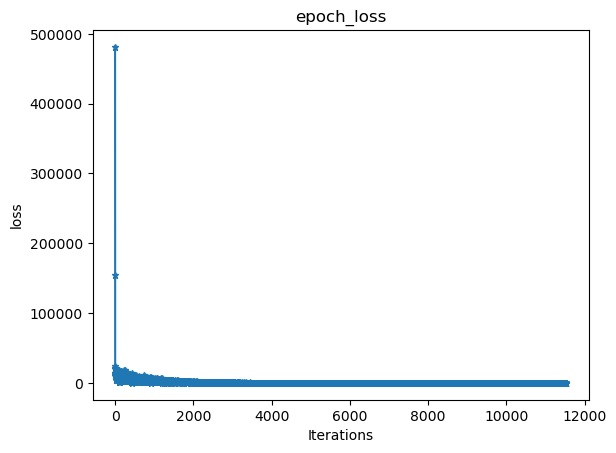

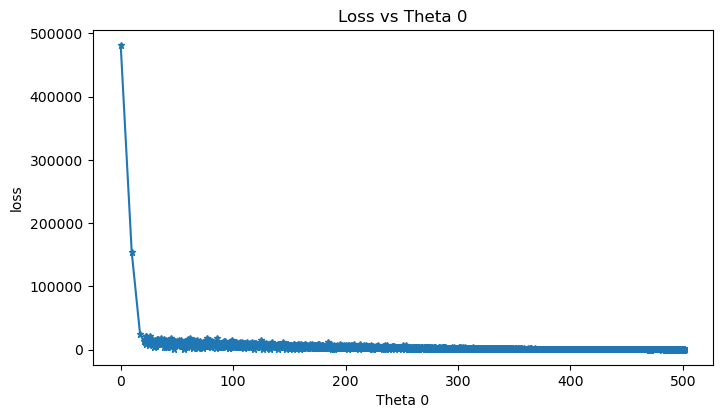

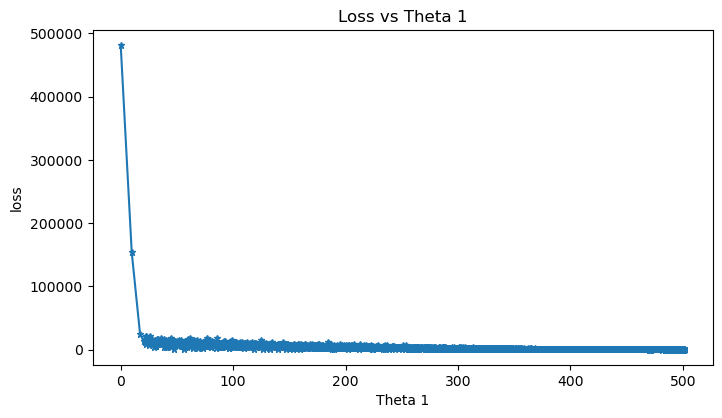

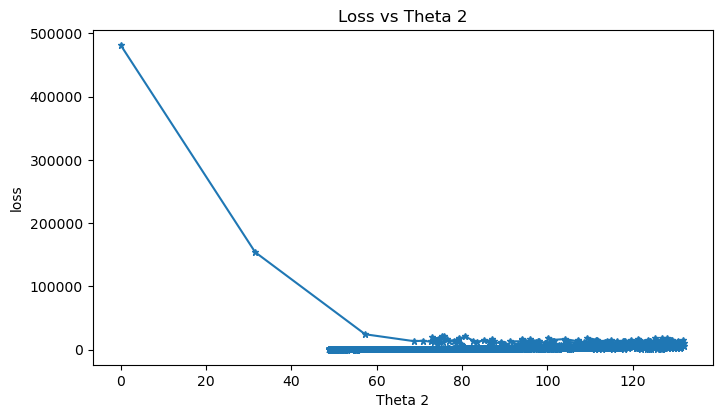

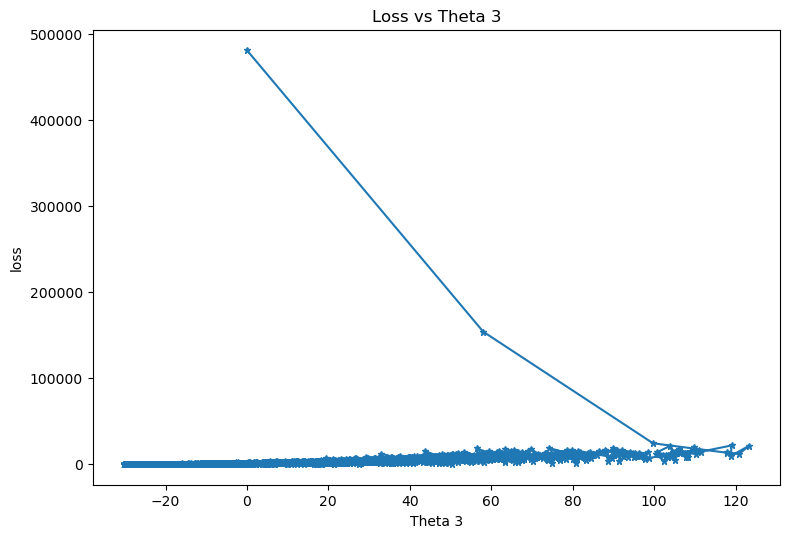

In [16]:
summary_plots(losses, all_thetas)

In [49]:
final_predictions = X @ theta
r2_score(y,final_predictions)

0.9693981152691148

###  stocatic multi varibale

In [50]:
theta, losses, all_thetas= momentum_mb_gd_mv(X, y, 0.01, 0.9, 1000, 1, 0.1, 0.1)

****************** Epoch 0 ********************
h(x): [988.71127391]
Error Vector:
[[-12.30647071]]
J = 75.72461071148112
Gradient Vector:
[[-12.30647071]
 [-12.30647071]
 [-36.21877945]
 [-57.93938022]]
Gradient Vector Norm: 70.51007167578962
Thetas_new: [443.41042181 443.41042181  69.44886901 -19.7087657 ]

****************** Epoch 1 ********************
h(x): [1000.17776294]
Error Vector:
[[-5.75414255]]
J = 16.555078265315856
Gradient Vector:
[[ -5.75414255]
 [ -5.75414255]
 [-16.53560707]
 [-26.47865115]]
Gradient Vector Norm: 32.2608986412597
Thetas_new: [498.69770555 498.69770555  48.46076088 -30.73002719]

****************** Epoch 2 ********************
h(x): [1091.93581737]
Error Vector:
[[1.75881193]]
J = 1.5467096987274105
Gradient Vector:
[[1.75881193]
 [1.75881193]
 [8.29481371]
 [8.86035583]]
Gradient Vector Norm: 12.389377657176476
Thetas_new: [499.98638948 499.98638948  42.46228498 -19.28275622]

****************** Epoch 3 ********************
h(x): [940.44237214]
Error

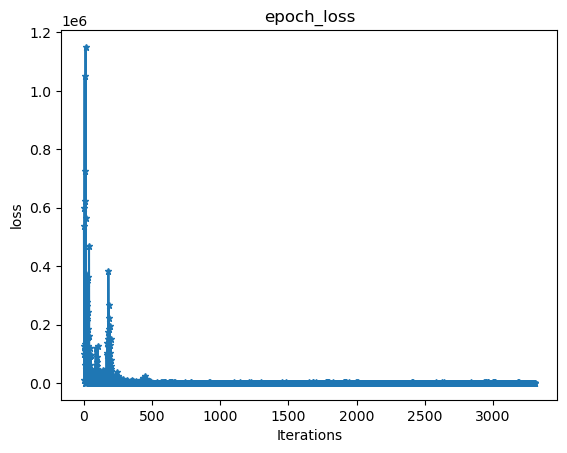

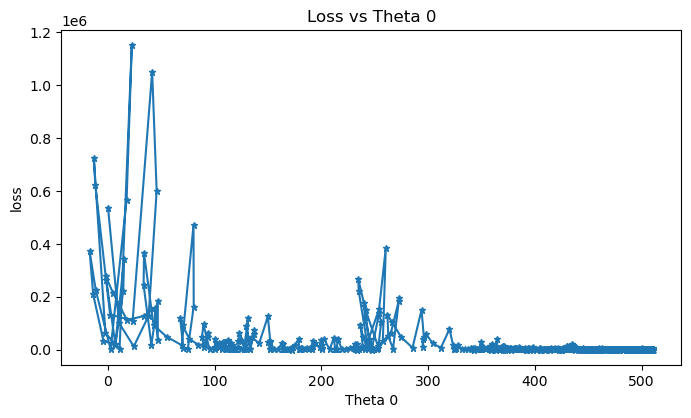

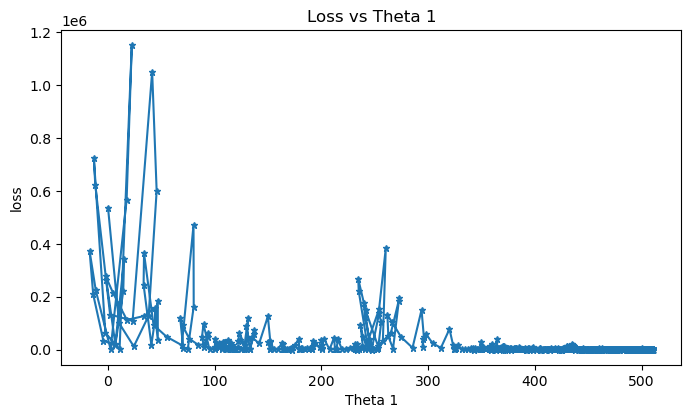

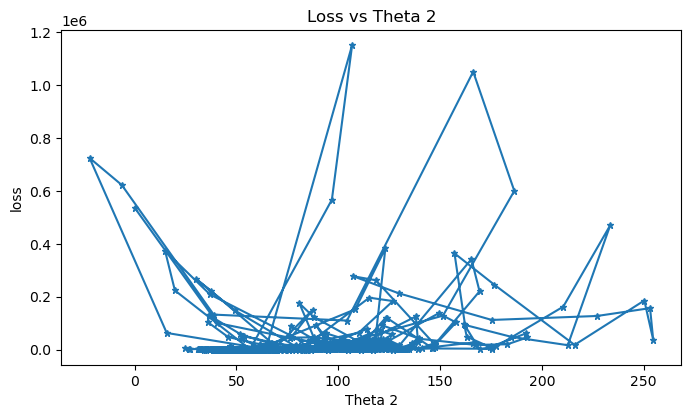

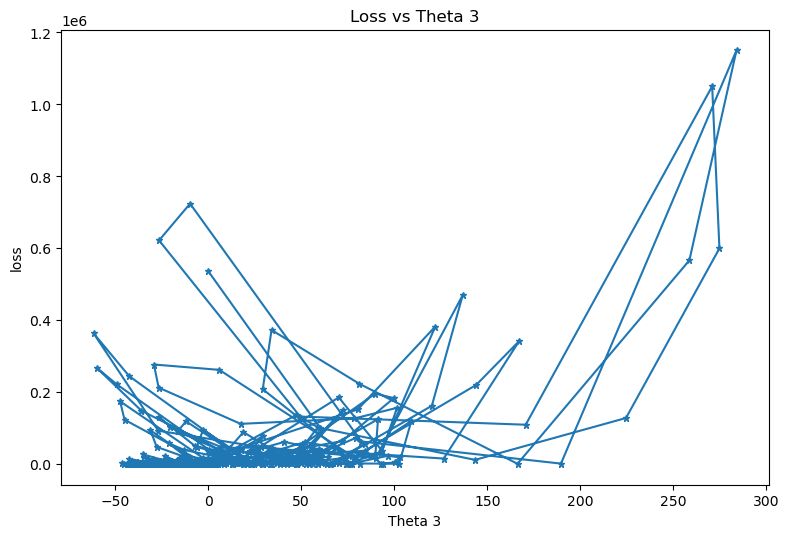

In [51]:
summary_plots(losses, all_thetas)

### momentom gradint descent 

In [52]:
theta, losses, all_thetas= momentum_mb_gd_mv(X, y, 0.01, 0.9, 1000, m, 0.1, 0.1)

****************** Epoch 0 ********************
h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Error Vector:
[[-2.04558263e+01]
 [-5.80682336e+00]
 [ 3.18683512e+01]
 [-4.77914941e+01]
 [ 3.51165745e+01]
 [-2.74267774e+01]
 [-2.22669999e+01]
 [ 1.30558564e+01]
 [-1.98298802e+01]
 [ 3.67498239e+01]
 [-1.70121360e+01]
 [ 1.65802417e+01]
 [-1.62974082e+01]
 [ 1.71719507e+01]
 [ 2.31142159e+01]
 [-3.53594076e+00]
 [ 1.94028483e-01]
 [ 8.78480771e+00]
 [-1.08243781e+01]
 [ 4.65991391e+01]
 [-1.34727810e+01]
 [ 2.48935278e+01]
 [-4.17388244e+01]
 [ 4.82329171e+00]
 [ 6.64000757e+00]
 [-1.34715030e+01]
 [-3.33189050e+01]
 [-9.94172373e+00]
 [-5.20134112e+01]
 [-3.04393034e+01]
 [ 4.58348117e+00]
 [-6.37948978e+00]
 [ 2.74964219e+01]
 [-1.13101007e+01]
 [ 1.27680700e+01]
 [-5.74100100e+01]
 [ 1.73486538e+00]
 [-5.64704908e+00]
 [ 2.14938502e+01]
 [-3.71258016e+00]
 [-2.77976580e+01]
 [-1.90806265e+01]
 [-1.72975412e+01]
 [ 1.63801817e+01]
 [-1.12554075e+01]
 [ 2.12456142e+01]
 [-1.91739257e+01]
 [ 1.58668802e-01]
 [ 1.14802404e+01]
 [-1.94234201e+01]
 [ 2.89095929e+01]
 [-3.12182401e+01

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



****************** Epoch 912 ********************
h(x): [1022.94824125  935.87347868 1045.39519474 1110.75571057 1012.11653018
 1012.18785929 1035.5414668  1090.40054288 1106.08775782 1026.44030624
 1001.75488149  955.20755306 1034.38935169  965.06675907  949.20426079
  957.0048031  1031.26924181 1100.7450296  1003.44997366 1031.36468421
 1005.51946888  987.16971786  935.75191951  962.1893244  1077.1302451
 1060.49070981  910.83758113 1014.10539102  985.12179439  988.91005754
  963.39994054 1015.44369109  986.02808309 1097.30891537  967.92861727
 1035.77541163  998.1433889  1046.59169132  885.2173942   976.63864731
  997.39722349  882.41150363 1057.13688377 1044.05047938  933.52275618
  883.04341293  954.46047036 1002.17478027 1035.88369473 1046.39066858
 1089.88498461 1070.09810233 1023.19773206  958.38007129 1053.48567824
 1070.73492596 1090.13126888  967.76525357 1029.10395619  962.52531033
 1051.10042806 1097.81508311 1046.77130347 1097.54701145 1077.17263889
  964.38834139  993.46

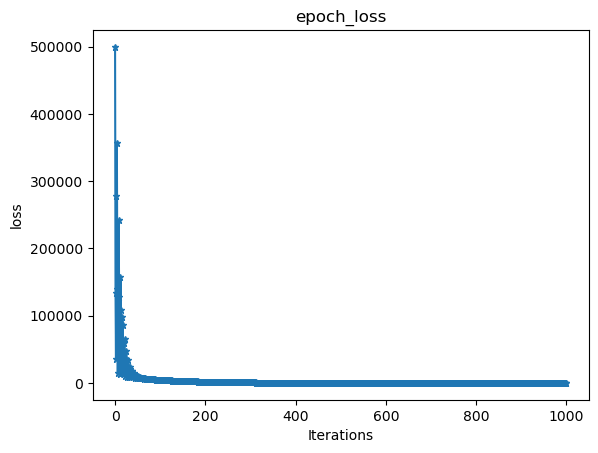

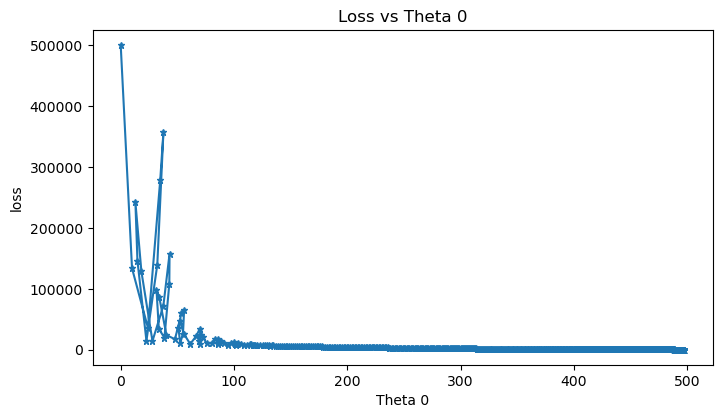

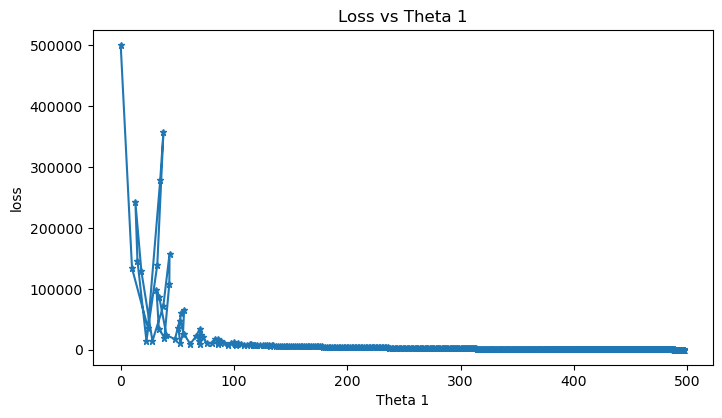

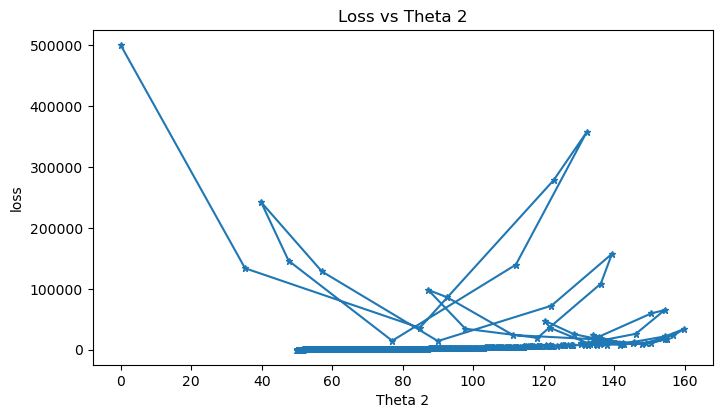

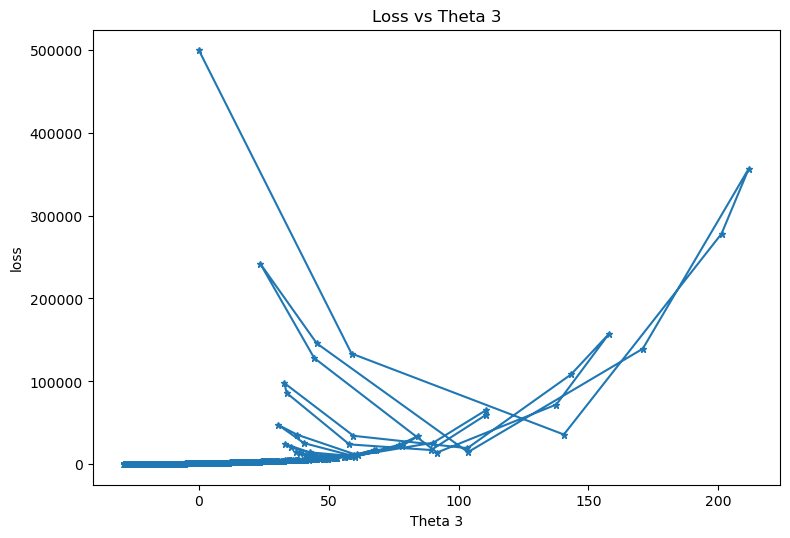

In [53]:
summary_plots(losses, all_thetas)

In [54]:
final_predictions = X @ theta
r2_score(y,final_predictions)

0.9689653195017264

### vanilla gradient descent  with mini batch

In [58]:
# theta, losses, all_thetas= momentum_mb_gd_mv(X, y, 0.01,1000, 15, 0.1, 0.1,0.1)

In [60]:
theta, losses, all_thetas= momentum_mb_gd_mv(X, y, 0.01, 0.9, 1000, m, 0.1, 0.1)

****************** Epoch 0 ********************
h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



****************** Epoch 429 ********************
h(x): [1049.49574495  962.49605908 1008.37457511 1017.01075572  947.45784674
 1094.88609371  978.90028178 1023.69119862  934.56600366  969.64820783
 1039.99470958 1020.73067966 1089.08662838  997.05138189 1069.96098398
 1090.58965374  984.57901297  940.48250741 1072.01466192 1032.74935846
 1021.87491577 1086.83746908  930.53430256  917.64685312 1024.61239879
  943.58303243 1012.40666026 1018.54025132  930.83634257  878.22433501
 1068.33251856 1011.03899101  931.91611134 1022.22114209  907.79634272
  920.06297101 1108.60760653  905.66350907 1079.1172601  1049.35992519
  982.76018025 1037.90574537  958.10506541  984.78978091 1020.08521993
  977.80699917  877.28980694 1060.34581381  892.57193845  970.51901894
 1083.53493228 1022.12004818  922.01333288  887.14210974 1012.20135339
 1079.67878806  984.28112764  975.61524114  892.39647633 1092.16763057
  952.62245166  941.30400663  922.99982542  969.04473035  891.59394488
  964.0893507   995.6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



****************** Epoch 944 ********************
h(x): [ 973.5248652  1002.00472181  929.92478925 1079.16793053 1029.52040894
 1046.49659776  926.51579778  970.47736305  995.60076651 1026.22131232
 1001.47492296  885.90898015  986.2862537   983.72553374  995.0913241
  958.25400039  988.32963475  949.88832668  904.73876419 1088.94815952
 1063.88246285 1119.37665559  983.66735922  965.84397184  911.3215796
 1104.80760941 1004.22052784 1075.23616767  987.66107307  946.07159801
 1045.90945282 1016.14526493 1052.75805401  967.51541715 1004.19723861
  963.35882534 1004.46964285  879.31677085 1029.40979878  900.5530689
 1004.02519809  985.77274347  997.04068598 1057.11879165 1096.92547515
 1013.94113816  969.58946409 1031.49021389 1046.08568068 1042.43403547
  995.55160078  980.08588449  959.69545039 1063.07996321  967.86375814
 1070.590423   1092.88395611  945.67310479  952.76649712  971.37688981
  956.71611316  959.77818315  955.90956401 1064.36173574 1001.20645881
 1011.97400663  983.4284

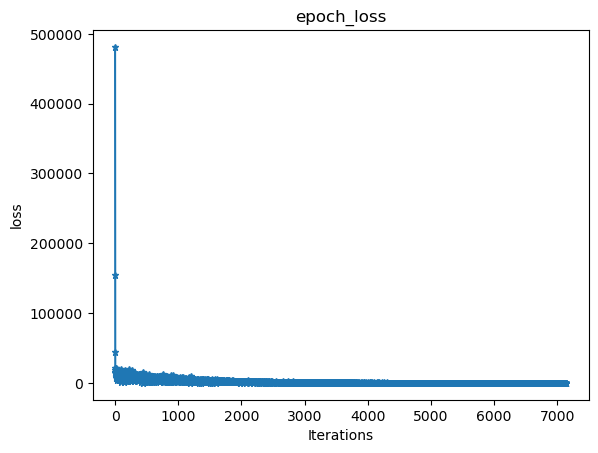

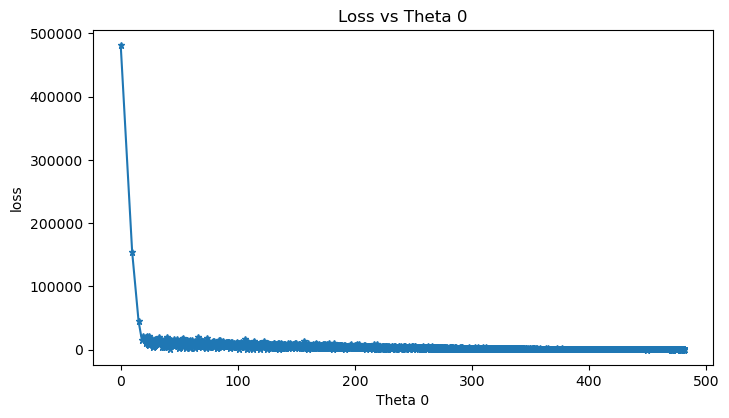

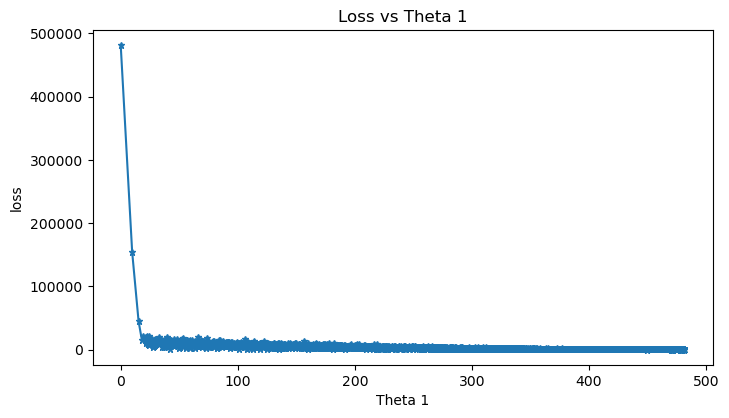

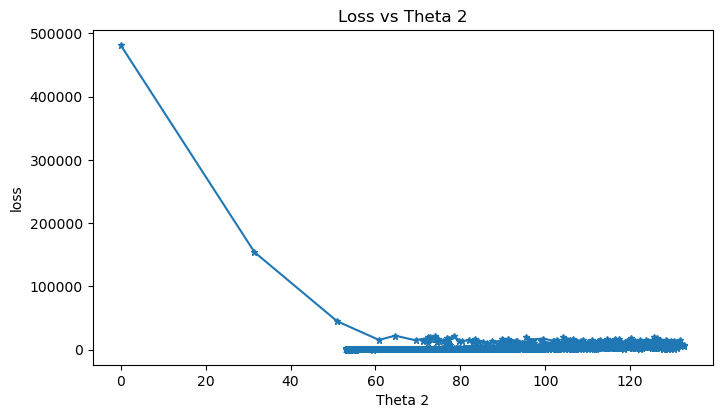

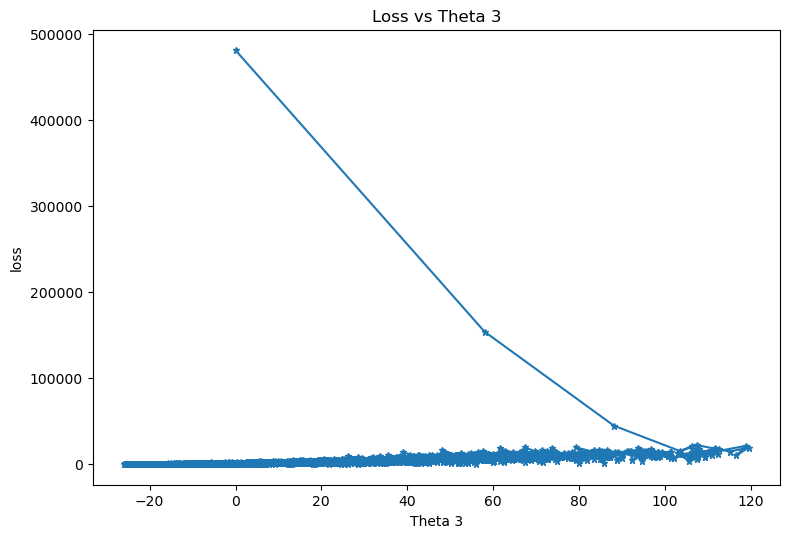

In [24]:
summary_plots(losses, all_thetas)

###  gradinet descent with stocatic

In [25]:
theta, losses, all_thetas= momentum_mb_gd_mv(X, y, 0.01,1000, 1, 0.001, 0.001)

****************** Epoch 0 ********************
h(x): [884.44901303]
Error Vector:
[[-116.56873159]]
J = 6794.134592245627
Gradient Vector:
[[-116.56873159]
 [-116.56873159]
 [-343.06969713]
 [-548.81047688]]
Gradient Vector Norm: 667.8819468954251
Thetas_new: [117.18770895 117.18770895 138.99509345  59.31722176]

****************** Epoch 1 ********************
h(x): [878.99382632]
Error Vector:
[[-126.93807918]]
J = 8056.637972500423
Gradient Vector:
[[-126.93807918]
 [-126.93807918]
 [-364.78036132]
 [-584.12684164]]
Gradient Vector Norm: 711.6849239769965
Thetas_new: [197.62661403 197.62661403 120.99581588  38.23340693]

****************** Epoch 2 ********************
h(x): [1099.41709728]
Error Vector:
[[9.24009183]]
J = 42.68964855015769
Gradient Vector:
[[ 9.24009183]
 [ 9.24009183]
 [43.57762149]
 [46.54875273]]
Gradient Vector Norm: 65.0888167785963
Thetas_new: [257.76027911 257.76027911  99.39669347  21.94302868]

****************** Epoch 3 ********************
h(x): [935.7572

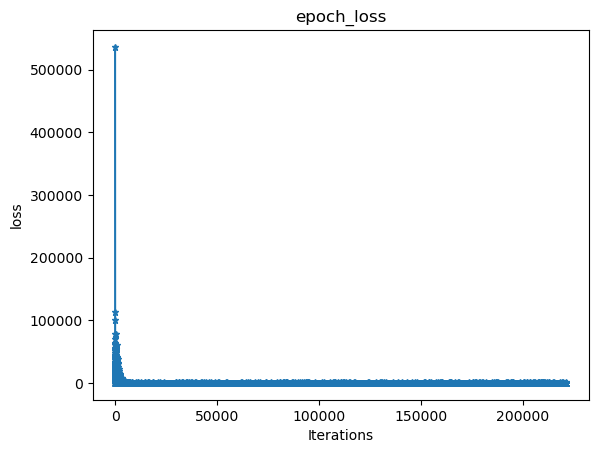

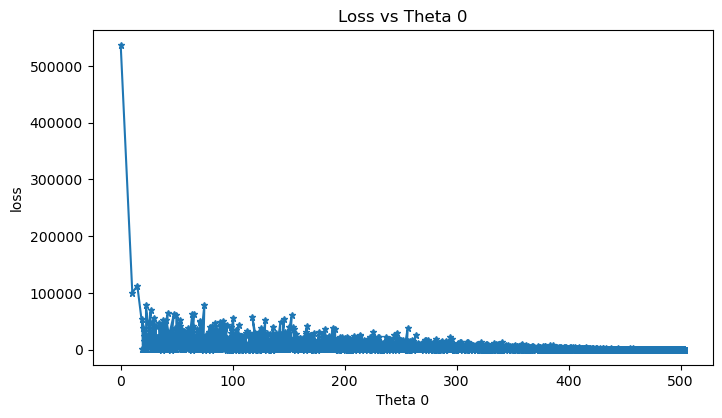

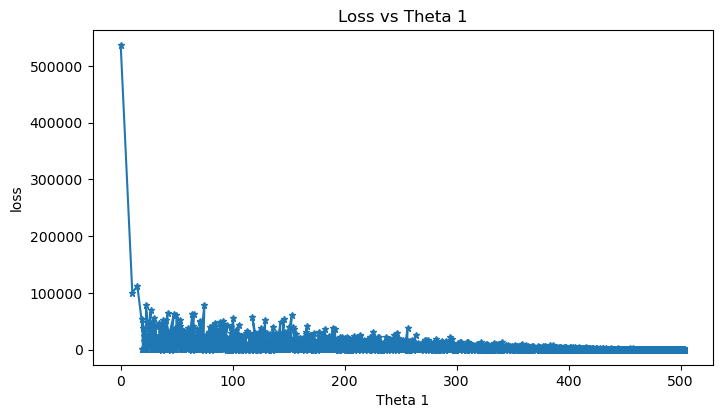

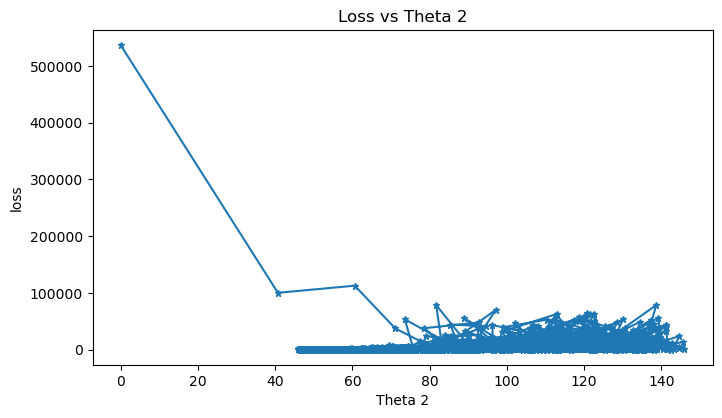

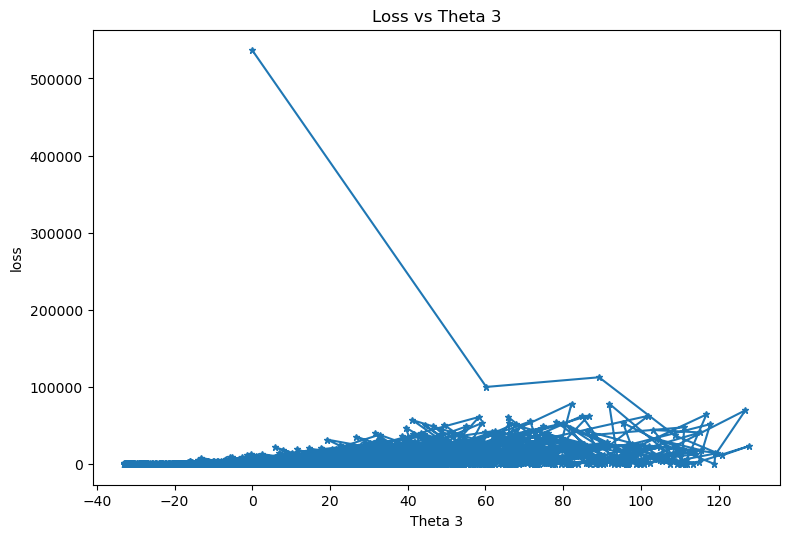

In [26]:
summary_plots(losses, all_thetas)

### gradient descent with minibath 

In [29]:
from sklearn.preprocessing import MinMaxScaler
pipleline = Pipeline([
        ('min_max', MinMaxScaler()),
    ])

In [30]:
X_final = num_pipeline.fit_transform(X[:,1:])
# y_final = num_pipeline.fit_transform(y)

In [31]:
m=len(y)
ones=np.ones((m,1))
X_final=np.concatenate((ones,X_final),axis=1)
X_final

array([[ 1.        ,  0.        , -0.41563649,  0.75807991],
       [ 1.        ,  0.        ,  1.51530965,  0.18984392],
       [ 1.        ,  0.        ,  0.78230693, -0.60455487],
       ...,
       [ 1.        ,  0.        , -1.4103277 , -1.21010975],
       [ 1.        ,  0.        ,  1.59467067,  1.64191136],
       [ 1.        ,  0.        ,  1.63426969, -0.12603308]])

In [32]:
theta, losses, all_thetas= momentum_mb_gd_mv(X_final, y, 0.01, 1000, m, 0.01, 0.01)

****************** Epoch 0 ********************
h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



****************** Epoch 458 ********************
h(x): [1062.77698261 1063.27034729  985.07485692 1032.22198124  870.78941102
  916.40843123  996.20350519  958.78010567  937.16135945  903.06573636
  966.9897626   980.78755299  967.00154697  978.08860166 1065.46822056
  978.39971918  981.75749477  963.40282484 1017.04616515 1079.07030598
  896.48500835  966.70727643 1013.58511339  946.55781493  933.78654611
  982.37248188  983.0705917   950.60251885  975.15258764  964.8006271
  992.75442645  980.78433486  972.1874386   983.7778546   958.9464818
 1110.21577011  948.71940922 1100.74302608 1018.82791017 1043.58920825
 1013.00640326  920.37481396  999.19916551 1012.27410265  872.64557062
  931.39565084 1032.39669684  952.66007519 1081.68432205 1076.00684368
  886.76048572  974.31264119 1013.19585243  988.92271149 1052.09545982
 1058.94797324 1042.3518242  1035.24730334  898.07146181 1083.72767101
  962.57261189 1082.76193505  948.97232769  914.31814376  947.31451178
 1024.11676053 1043.817

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [33]:
theta, losses, all_thetas= momentum_mb_gd_mv(X_final, y, 0.01, 1000,m, 0.01, 0.01)

****************** Epoch 0 ********************
h(x): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



****************** Epoch 373 ********************
h(x): [ 918.70097474  970.53220491  967.35743003 1033.1188231   930.12626038
  953.04766623  965.27894375  977.77214953  900.52878759  953.78656113
 1000.72291498  994.12439599  968.29099394 1072.49488676  899.63715101
  998.61371108  897.69752182  880.09911415  967.39615911  889.86706185
  865.15638428 1047.57858164  845.20779086  933.81105395  949.34962113
  946.56390045  973.41984503  966.70071519  967.22876657  936.81591214
 1038.3572915  1028.08590327 1037.71109328  877.96696634 1008.8312522
  916.44783471 1062.48277041  903.92369666  969.17863366  998.65656493
  957.01590164 1000.67086207  934.93516448  997.17729262 1037.99099567
  999.14853441 1060.21471133  999.33378599  942.12674974  991.31758102
 1031.37263706 1021.92095296  956.08580005  949.89628957  906.12375928
 1044.45293489  996.91600189  939.66571705  881.30769065 1029.53633211
 1055.36647854  939.59980125 1021.06795086  977.55813231  905.65516449
  930.28968052  953.50

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



****************** Epoch 662 ********************
h(x): [ 938.90303212  999.31462547 1051.56754006 1026.88835826 1061.37667263
 1031.07858201  934.41824233  884.19353087 1001.520338    911.00033199
  975.51121704 1054.12742748 1032.38481102  986.70923286  967.05028465
  954.88972193 1049.6246165   955.77669076  989.72250473  968.10388029
  930.11355831 1096.50578295 1022.54025222 1071.51141792 1045.53828267
 1032.87699692  991.73724631 1041.51583312 1053.17120132  970.07355542
  970.98211393 1064.17749669  982.33420319 1046.7955416  1010.7167753
 1093.32313691  967.40028848  994.38856953  952.24294407  981.95838026
 1019.0606645  1047.72225695 1103.72950763  987.25318467  951.30417989
  954.37747453  951.58035936  945.38586826 1064.34539471 1085.53655106
  952.619956   1033.1600318  1012.98530874 1029.2638971  1016.81177511
 1068.31221791  904.35721331  986.43987412  871.75473385 1042.98077628
 1043.44868477 1092.34912771  965.67774481  959.01441899  897.6894605
  981.86620732  980.919

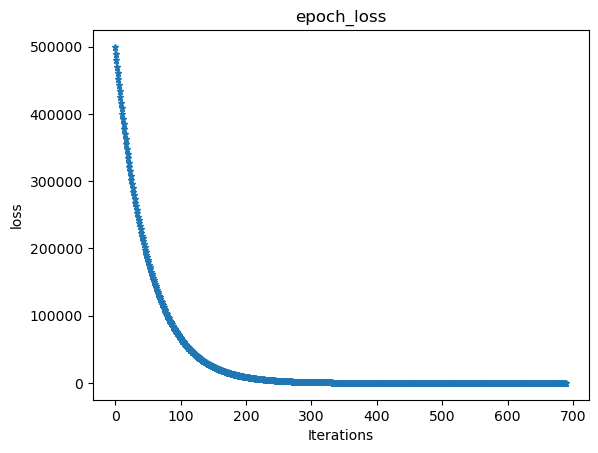

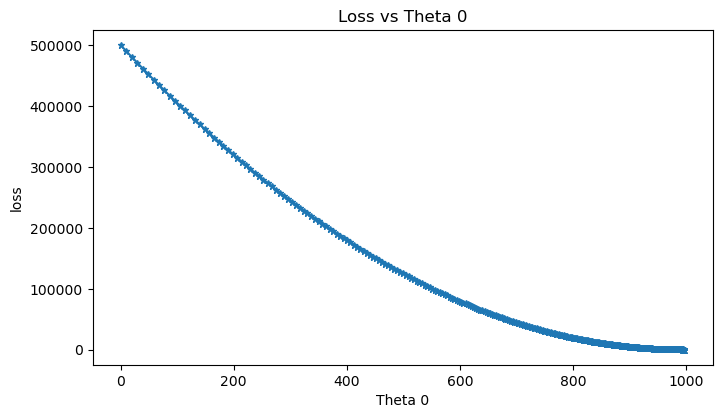

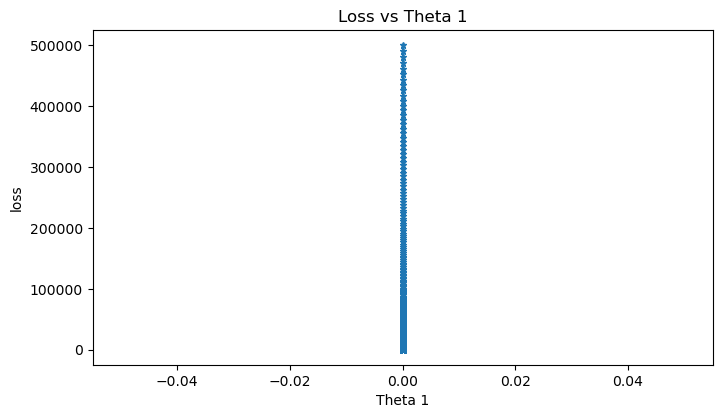

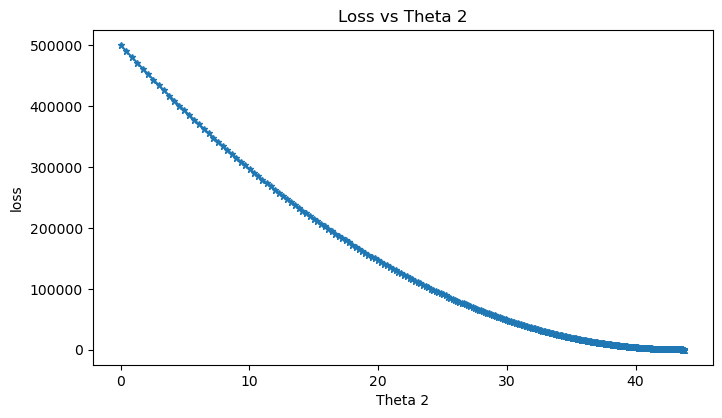

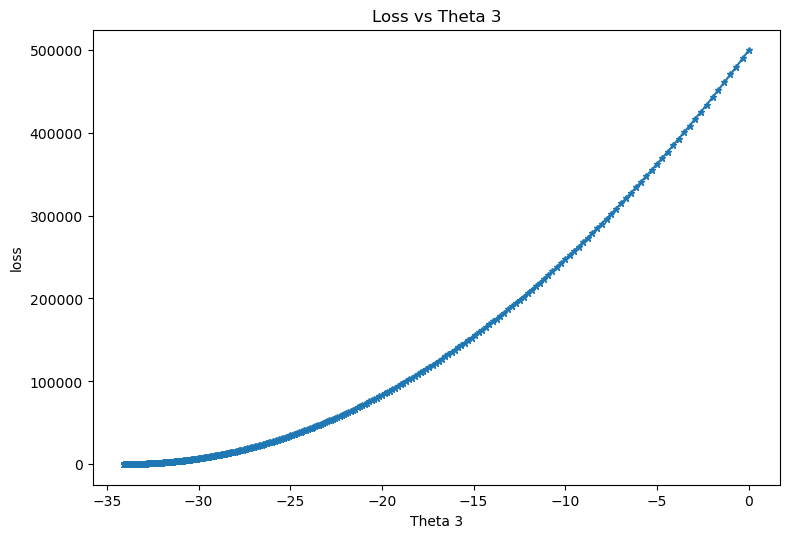

In [34]:
summary_plots(losses, all_thetas)

In [ ]:
theta, losses, all_thetas= momentum_mini_batch_gradient_descent_multivar(X, y, lr=0.01,n_iter=1000, batch_size=32, convergence_rate=0.1, norm_value_check=0.1)